In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3468.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1853.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1317.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1159.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/2803.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3198.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3370.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/2342.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1151.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1605.xml
/kaggle/input/military-aircraf

# **1. Загрузка необходимых модулей**

In [ ]:
import torch
torch.cuda.empty_cache()

In [2]:
!pip install split-folders # разбивает данные по папкам train, val, test
# !pip install colorama
!pip install torchinfo
!pip install -q --upgrade selectivesearch torch_snippets

In [3]:
%%capture
import os
import cv2
import tqdm
import torch
import shutil
import numpy as np
import splitfolders
import pandas as pd
from PIL import Image
import selectivesearch
from IPython import display
from torchinfo import summary
#from torch_snippets import * #не дает сделать цветной вывод
from torchvision.ops import nms
import matplotlib.pyplot as plt
from torch.optim import SGD, Adam
from torch_snippets import Report, Glob, show, read
import xml.etree.ElementTree as et
from colorama import Fore,Back,Style,init
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models, datasets
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
device = 'cuda' if torch.cuda.is_available() else 'cpu'
import matplotlib.patches as patches
from torch import nn

# **3. Создаем DataFrame с данными**

In [4]:
images = '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages'
annotations_4 = '/kaggle/input/military-aircraft-recognition-dataset/Annotations/Horizontal Bounding Boxes'
# annotations_8 = '/content/Annotations/Oriented Bounding Boxes'

In [5]:
images_paths = sorted([str(i) for i in Glob(f'{images}/*.jpg')])
len(images_paths)

3842

In [7]:
annotation_paths_4 = sorted([str(i) for i in Glob(f'{annotations_4}/*.xml')])
len(annotation_paths_4)
#annotation_paths_4

3842

In [8]:
picture =[]
way_pic =[]
way_ann =[]
target = []
X_left = []
Y_down = []
X_right = []
Y_up = []
width = []
height = []
for i,j in enumerate(annotation_paths_4):
  tree = et.parse(j)
  #root = tree.getroot()
  pic_name = images_paths[i].split('/')[-1][:-4]
  for el in tree.findall('object'):
    picture.append(f'{pic_name}.jpg')
    way_ann.append(j)
    way_pic.append(images_paths[i])
    target.append(el.find('name').text)
    X_left.append(el.find('bndbox').find('xmin').text)
    Y_down.append(el.find('bndbox').find('ymin').text)
    X_right.append(el.find('bndbox').find('xmax').text)
    Y_up.append(el.find('bndbox').find('ymax').text)
    for _ in tree.findall('size'):
      ww = _.find('width').text
      hh = _.find('height').text
      width.append(ww)
      height.append(hh)
    #X_left,Y_down,X_right,Y_up = [X_left / ww, Y_down / hh, X_right / ww, Y_up / hh]

name_col = ['ImageID', 'LabelName', 'X_left', 'Y_down', 'X_right', 'Y_up','width','height', 'way_pic', 'way_ann']
lst = picture, target, X_left, Y_down, X_right, Y_up, width, height, way_pic, way_ann
df = pd.DataFrame(np.column_stack(lst), columns = name_col)
DF_RAW = df = df[df.ImageID.str.contains('.jpg')]

df.X_left = np.around((df.X_left.astype(float)/df.width.astype(float)),6)
df.X_right = np.around(df.X_right.astype(float)/df.width.astype(float),6)
df.Y_down = np.around(df.Y_down.astype(float)/df.height.astype(float),6)
df.Y_up = np.around(df.Y_up.astype(float)/df.height.astype(float),6)
#df[['XMin','XMax']] = df[['XMin','XMax']].astype(float)/df[['width','width']].astype(float)
#df[['YMin','YMax']] = df[['YMin','YMax']].astype(float)/df[['height']]
df.sample(4)

,ImageID,LabelName,X_left,Y_down,X_right,Y_up,width,height,way_pic,way_ann
19851,664.jpg,A11,0.274460,0.182895,0.354511,0.253947,787,760,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
5177,1865.jpg,A14,0.265000,0.125000,0.378750,0.235000,800,800,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
20169,694.jpg,A7,0.309684,0.551597,0.386385,0.652334,1043,814,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
19652,636.jpg,A3,0.230058,0.053659,0.317919,0.145122,865,820,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...


In [9]:
# удаляем строки со значениями inf
df = DF_RAW = df[df.X_left != np.inf]

In [10]:
df.shape

(22218, 10)

In [11]:
df.dtypes

ImageID       object
LabelName     object
X_left       float64
Y_down       float64
X_right      float64
Y_up         float64
width         object
height        object
way_pic       object
way_ann       object
dtype: object

# **4. Смотрим картинки с коробками и метками**

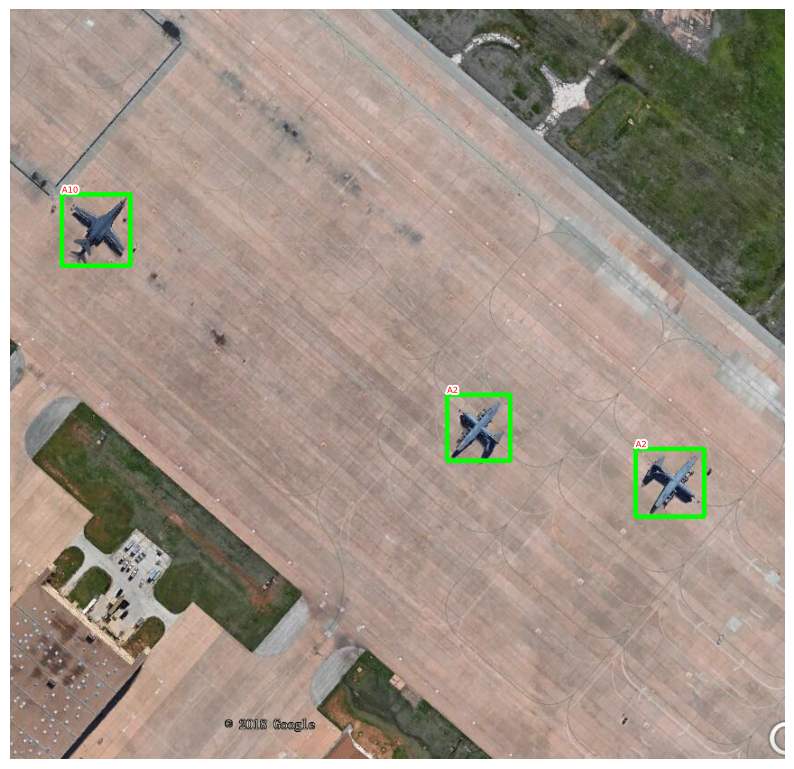

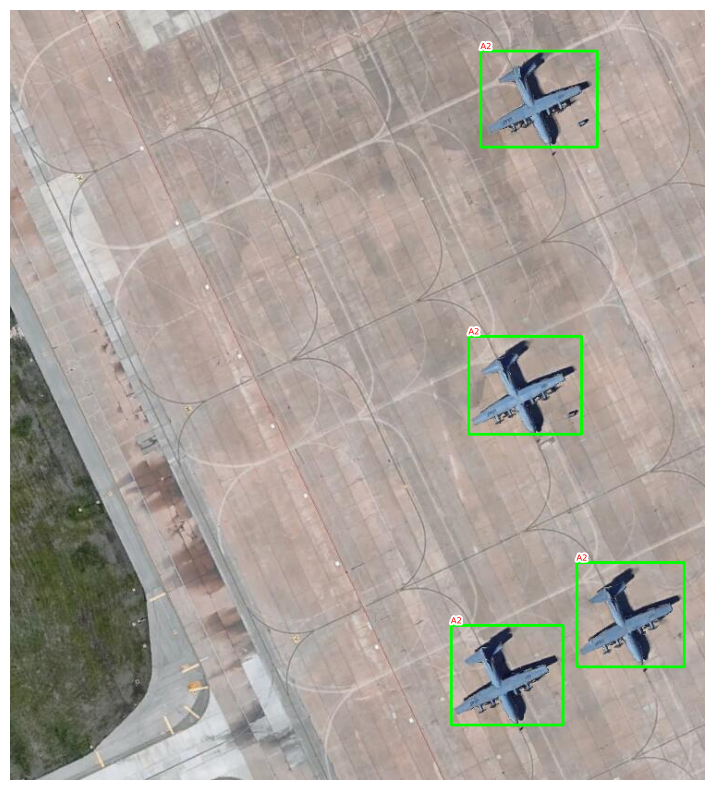

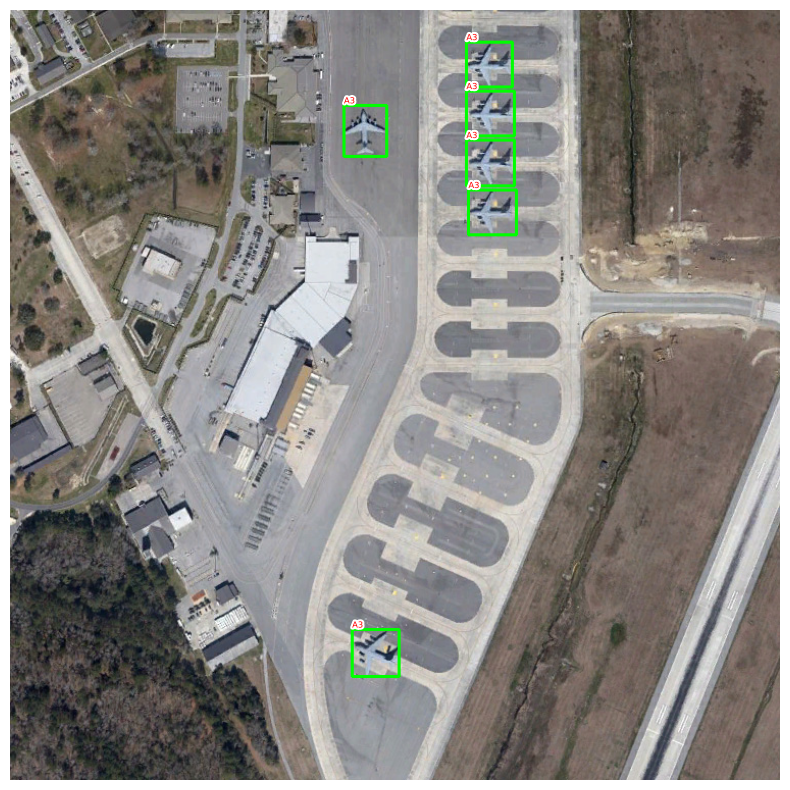

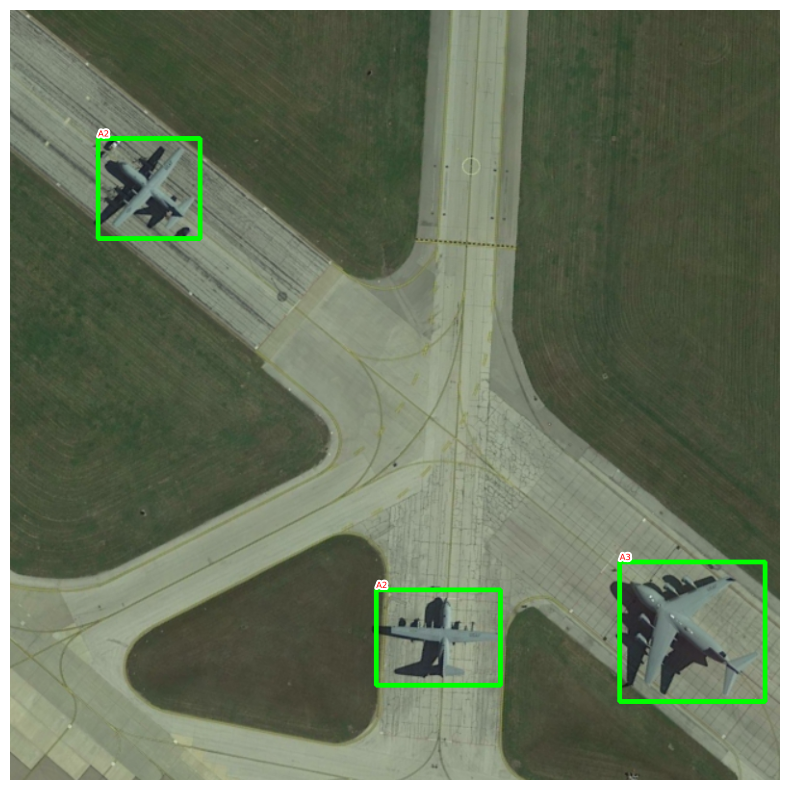

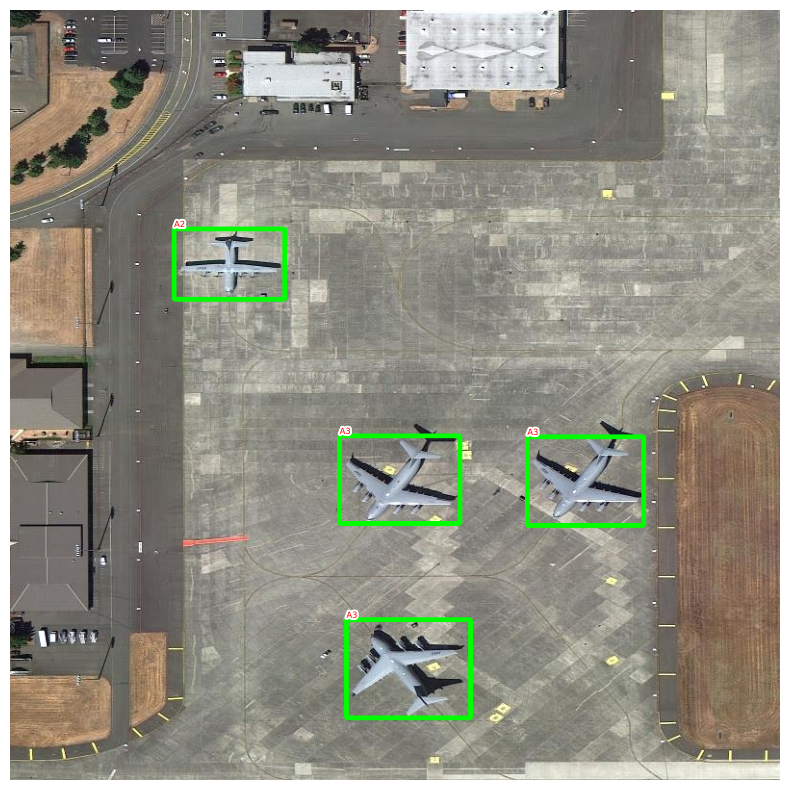

...

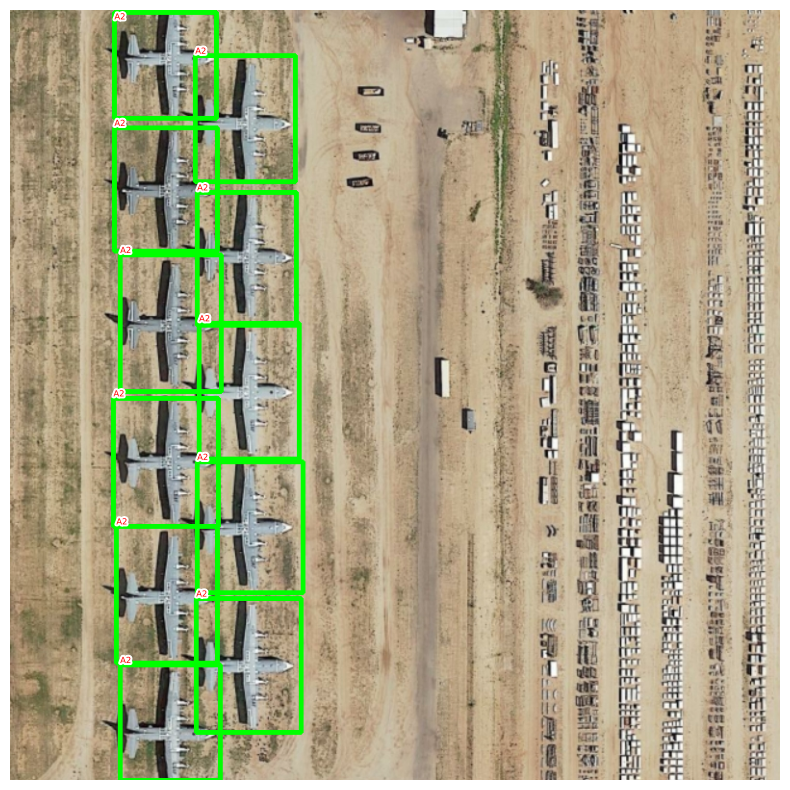

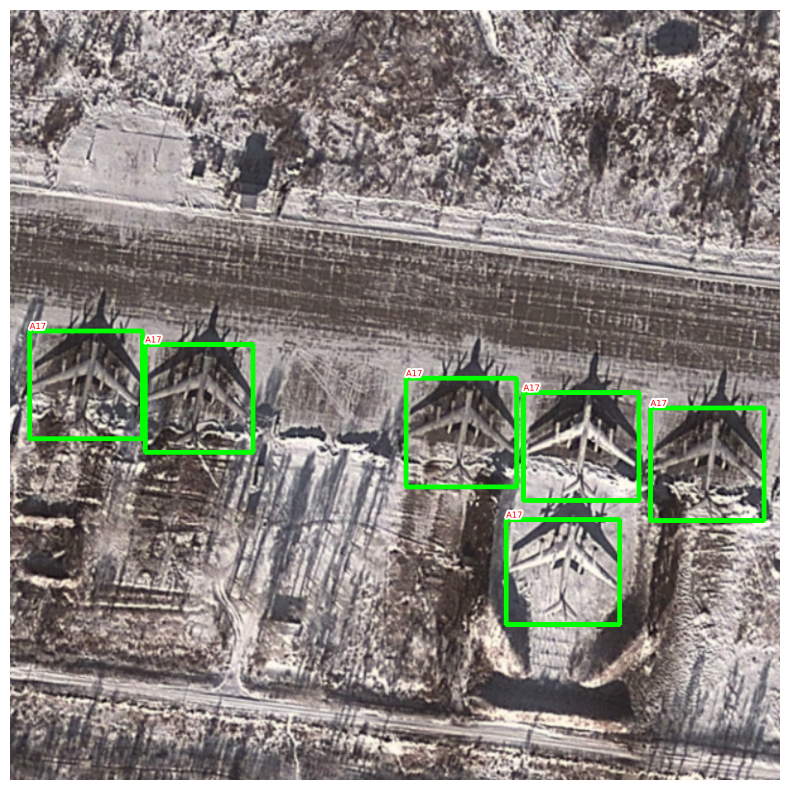

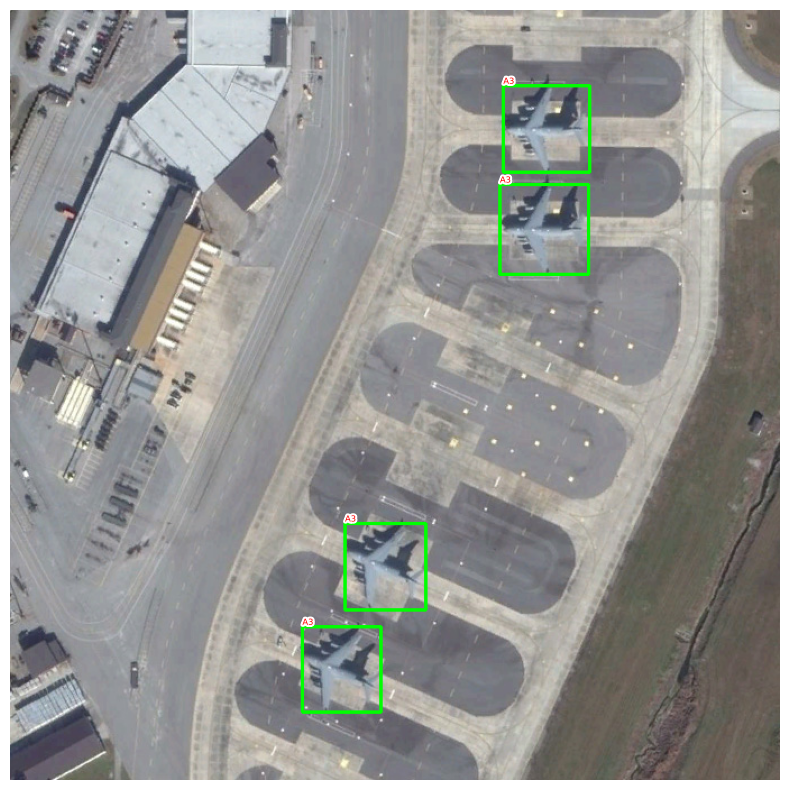

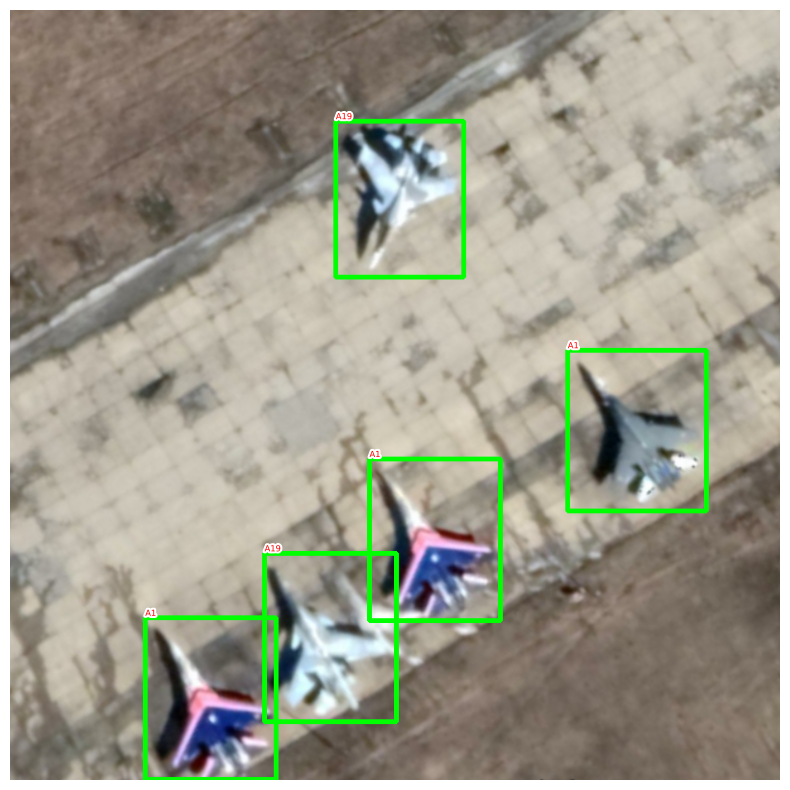

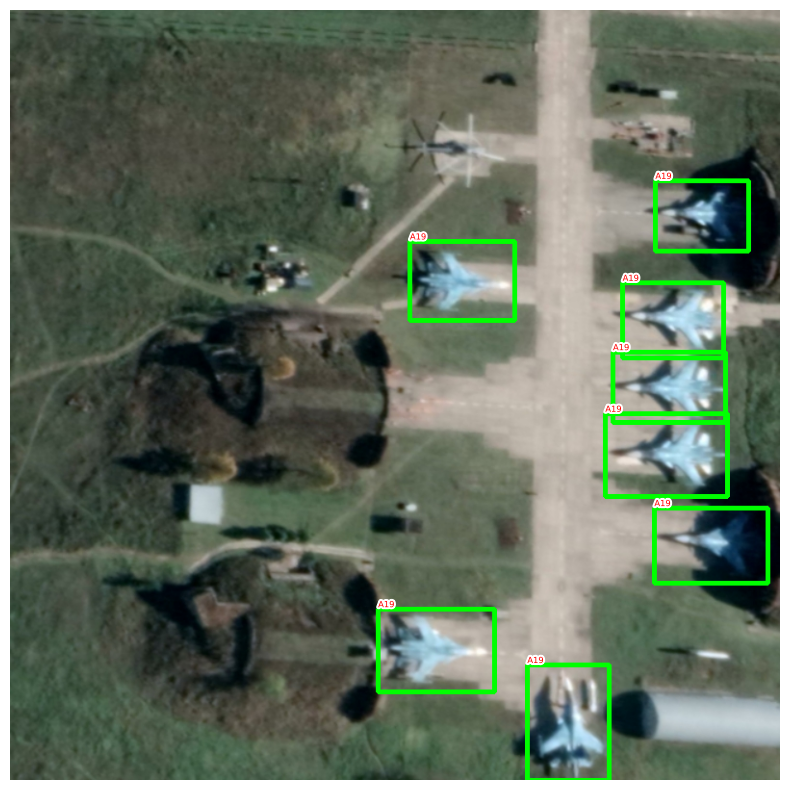

In [12]:
class OpenImages(Dataset):
    def __init__(self, df, image_folder='/kaggle/input/military-aircraft-recognition-dataset/JPEGImages'):
        self.root = image_folder
#        self.root = [str(i) for i in self.root]
        self.df = df
        self.unique_images = df['ImageID'].unique()
    def __len__(self): return len(self.unique_images)
    def __getitem__(self, ix):
        image_id = self.unique_images[ix]
        image_path = f'{self.root}/{image_id}'
#        print(image_path)
        image = cv2.imread(image_path, 1)[...,::-1]#.convert('RGB') # conver BGR to RGB
#        print(image.shape)
        #print(image)
        h, w, _ = image.shape
        df = self.df.copy()
        df = df[df['ImageID'] == image_id]
        boxes = df['X_left,Y_down,X_right,Y_up'.split(',')].values
        boxes = (boxes * np.array([w,h,w,h])).astype(np.uint16).tolist()
        classes = df['LabelName'].values.tolist()
        return image, boxes, classes, image_path
#for i,j in DF_RAW.head(4).iterrows():
ds = OpenImages(df=DF_RAW)
for _,i in enumerate(ds):
  if _ > 15: break
  else:
    im, bbs, clss, _ = i
#     print(im)
#     print(bbs)
#     print(clss)
    show(im, bbs=bbs, texts=clss, sz=10)

# **5. Создаем Классы и кодируем**

In [13]:
# если данные в VOC-format (.xml), то поступаем так:
def Classes(df):
    #LabelName = df.LabelName.unique().to_list()
    list_classes = list(df.LabelName.unique())
    list_classes.sort()
    list_classes.insert(0, 'background') # вставляет элемент в нулевую позицию
    label2targets = {l: t for t, l in enumerate(list_classes)}
    targets2label = {t: l for l, t in label2targets.items()}
    num_classes = len(targets2label)
    return label2targets, targets2label, num_classes
label2targets, targets2label, num_classes = Classes(df)

print(label2targets)
print(targets2label)
print(num_classes)

{'background': 0, 'A1': 1, 'A10': 2, 'A11': 3, 'A12': 4, 'A13': 5, 'A14': 6, 'A15': 7, 'A16': 8, 'A17': 9, 'A18': 10, 'A19': 11, 'A2': 12, 'A20': 13, 'A3': 14, 'A4': 15, 'A5': 16, 'A6': 17, 'A7': 18, 'A8': 19, 'A9': 20}
{0: 'background', 1: 'A1', 2: 'A10', 3: 'A11', 4: 'A12', 5: 'A13', 6: 'A14', 7: 'A15', 8: 'A16', 9: 'A17', 10: 'A18', 11: 'A19', 12: 'A2', 13: 'A20', 14: 'A3', 15: 'A4', 16: 'A5', 17: 'A6', 18: 'A7', 19: 'A8', 20: 'A9'}
21


# **6. Компануем данные для подачи в Dataloader**

In [14]:
def create_dataset(data_path: str, target_path: str) -> pd.DataFrame:
    assert isinstance(data_path, str)
    assert isinstance(target_path, str)

    dict_paths = {
        "image": [],
        "annotation": []
    }

    for dir_name, _, filenames in os.walk(data_path):
        for filename in filenames:
            name = filename[:-4]
            dict_paths["image"].append(f"{data_path}/{name}.jpg")
            dict_paths["annotation"].append(f"{target_path}/{name}.xml")


    dataframe = pd.DataFrame(
        data=dict_paths,
        index=np.arange(0, len(dict_paths["image"]))
    )

    return dataframe

In [15]:
df_ways = create_dataset(
    data_path=images,
    target_path=annotations_4
)
print(df_ways.shape)
df_ways.head(8)

(3842, 2)


,image,annotation
0,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
1,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
2,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
3,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
4,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
5,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
6,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
7,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...


In [16]:
def preprocess_img(img):
    img = torch.tensor(img).permute(2, 0 ,1)
    return img.float()

class FlyDataset(Dataset):
    def __init__(self, df, transforms=None):
        self.root = df
        self.transforms = transforms
        # self.img_paths = sorted([str(i) for i in Glob(self.root + '/images/images/*.jpg')])
        # self.xlm_paths = sorted([str(i) for i in Glob(self.root + '/annotation/annotation/VOC-format/*.xml')])
        # self.img_paths = sorted([k for k, v in roo])
        # self.xlm_paths = sorted([v for k, v in roo])
        self.img_paths = self.root.image.to_list()
        self.xlm_paths = self.root.annotation.to_list()

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        #----------------------
        # достаем факт размер картинки (Image.open достает W и H)
        w, h = 224, 224
        img_path = self.img_paths[idx]
        xlm_path = self.xlm_paths[idx]
        img = Image.open(img_path).convert('RGB')
        W, H = img.size
        #----------------------
        # достаем картинку, меняем размер (появляются 3-й канала)
        img = np.array(img.resize((w, h),
                       resample=Image.Resampling.BILINEAR))/255.
        #print(img.shape)
        #print(img)
        #----------------------
        # достаем коробки, метки и компануем в словарь
        xlm = et.parse(xlm_path)
        objects = xlm.findall('object')
        labels = []
        boxes = []
        for obj in objects:
            XMin = float(obj.find('bndbox').find('xmin').text)
            YMin = float(obj.find('bndbox').find('ymin').text)
            XMax = float(obj.find('bndbox').find('xmax').text)
            YMax = float(obj.find('bndbox').find('ymax').text)
            bbox = [XMin / W, YMin / H, XMax / W, YMax / H]
            bbox = (bbox * np.array([w, h, w, h])).astype(np.int16).tolist()
            #---------------------------------------------------
            # условная вставка, которая удаляет нулевые и близкие к нулю коробки
            if (bbox[2] - bbox[0]) < 0.005 or (bbox[3] - bbox[1]) < 0.005: continue
            else:
            #---------------------------------------------------
              boxes.append(bbox)
              label = obj.find('name').text#.replace('Pedestrian','Человек')
              labels.append(label)
        target = {}
        target['labels'] = torch.tensor([label2targets[label] for label in labels]).long()
        target['boxes'] = torch.tensor(boxes).float()
        #----------------------
        # преобразуем картинку согласно функции preprocess_img
        #img = preprocess_img(img)
        #----------------------
        # блок transforms
        #if self.transforms:
        if self.transforms:
            sample = self.transforms(image = img,
                                     bboxes = target['boxes'],
                                     labels = labels)
            img = sample['image']
            img = img.float()
            target['boxes'] = torch.Tensor(sample['bboxes'])
        #----------------------
        # блок преобразования без transforms (вроде вообще не нужен, достаточно установить False)
        # пока не удаляем
        #else: img = preprocess_img(img)
        #----------------------
        return img, target

    def collate_fn(self, batch):
        return tuple(zip(*batch))

# **7. Блок трансформации**

In [17]:
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
def get_transform(train):
    if train:
        return A.Compose([
            A.HorizontalFlip(0.5),
            A.VerticalFlip(0.3),
            ToTensorV2(p=1.0)
        ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})
    else:
        return A.Compose([
            ToTensorV2(p=1.0)
        ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

# **8. train_test_split**

In [18]:
# Разбивка данных на основе столбца с именами картинок в df
from sklearn.model_selection import train_test_split
trn_ids, val_ids = train_test_split(df_ways.image.unique(), test_size=0.1, random_state=99)
# типа разбивка df на train_df и val_df на основе разбивки train_test_split
trn_df, val_df = df_ways[df_ways['image'].isin(trn_ids)], df_ways[df_ways['image'].isin(val_ids)]
#print(trn_df, val_df)
len(trn_df), len(val_df)

(3457, 385)

# **9. Создаем загрузчики**

torch.Size([3, 224, 224])


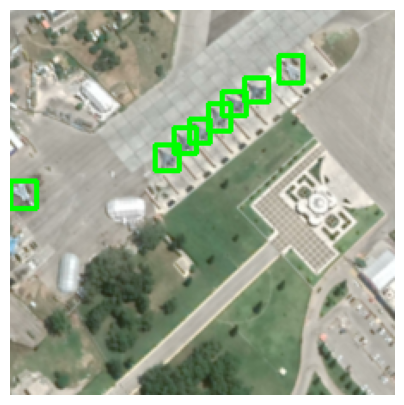

In [36]:
train_ds = FlyDataset(trn_df, transforms=get_transform(train=False)) # False True
print(train_ds)
train_dl = DataLoader(train_ds, batch_size=8, shuffle=True, collate_fn=train_ds.collate_fn)

val_ds = FlyDataset(val_df, transforms=get_transform(train=False))
val_dl = DataLoader(val_ds, batch_size=8, shuffle=True, collate_fn=val_ds.collate_fn, drop_last=True)

# test_ds = FruitsDataset(test, transforms=get_transform(train=False))
# test_dl = DataLoader(test_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn, drop_last=True)
print(train_ds[2][0].shape)
img, target = train_ds[3]
# plot_img_bbox(img.permute(1,2,0), target['boxes'])
show(img.permute(1,2,0), bbs=target['boxes'])#, texts=target['labels'], sz=6)

In [20]:
for i in train_ds:
    print(len(i))
    break

2


In [21]:
for i in train_ds:
    print(i)
    break

(tensor([[[0.3373, 0.3294, 0.3255,  ..., 0.2902, 0.2863, 0.2824],
         [0.3294, 0.3216, 0.3255,  ..., 0.2863, 0.2902, 0.2863],
         [0.3176, 0.3098, 0.3255,  ..., 0.2902, 0.2902, 0.2902],
         ...,
         [0.5608, 0.5961, 0.6118,  ..., 0.2510, 0.2471, 0.2431],
         [0.6627, 0.6784, 0.6941,  ..., 0.2706, 0.2588, 0.2549],
         [0.7020, 0.7137, 0.7294,  ..., 0.2863, 0.2784, 0.2745]],

        [[0.4471, 0.4392, 0.4353,  ..., 0.3725, 0.3686, 0.3647],
         [0.4275, 0.4157, 0.4157,  ..., 0.3686, 0.3725, 0.3686],
         [0.3765, 0.3569, 0.3686,  ..., 0.3765, 0.3725, 0.3725],
         ...,
         [0.5882, 0.6118, 0.6235,  ..., 0.4078, 0.4078, 0.4078],
         [0.6549, 0.6706, 0.6863,  ..., 0.4275, 0.4196, 0.4196],
         [0.6784, 0.6941, 0.7059,  ..., 0.4431, 0.4353, 0.4275]],

        [[0.3569, 0.3490, 0.3451,  ..., 0.3059, 0.3020, 0.2980],
         [0.3412, 0.3294, 0.3333,  ..., 0.3020, 0.3059, 0.3020],
         [0.2980, 0.2824, 0.2941,  ..., 0.3059, 0.3059, 0

# **10. Функция mAP**

Здесь 4 функции:
1. **in_for_mAP_true**: преобразует форму батча в список списков для подачи в функцию mean_average_precision

2. **in_for_mAP_pred**: преобразует форму предсказанных моделью значений (boxes, labels,scores) в список списков для подачи в функцию mean_average_precision

3. **insert_over_union**: считает IoU, используется в теле mean_average_precision

4. **mean_average_precision**: вычисляет mAPЗдесь 4 функции:
1. **in_for_mAP_true**: преобразует форму батча в список списков для подачи в функцию mean_average_precision

2. **in_for_mAP_pred**: преобразует форму предсказанных моделью значений (boxes, labels,scores) в список списков для подачи в функцию mean_average_precision

3. **insert_over_union**: считает IoU, используется в теле mean_average_precision

4. **mean_average_precision**: вычисляет mAP

# **true_boxes:**

в формат: индекс_картинкивбатче, класс_самолета, степень_точночти, Xmin, Ymin, Xmax, Ymax

In [22]:
def in_for_mAP_true(batch):
    lst=batch[1]
    ground_date=[]
    for i,_ in enumerate(lst):
        t=list(zip(_['labels'],_['boxes']))
        lst_data =[]
        for k in t:
            f=[i,k[0]]
            f.extend(k[1])
            f.insert(2,float(1))
            lst_data.append([int(i) for i in f])
        ground_date.extend(lst_data)
    return ground_date

# **pred_bboxes:**

In [23]:
def in_for_mAP_pred(batch):
    pred_date=[]
    for i,_ in enumerate(batch):
        t=list(zip(_['labels'],_['scores'],_['boxes']))
        lst_data =[]
        precision=[]
        for k in t:
            f=[i,k[0],k[1]]
            precision.append(round(float(k[1]),3))
            f.extend(k[2])
            lst_data.append([int(i) for i in f])
        for i,_ in enumerate(lst_data):
            for j,k in enumerate(precision):
                if i == j:
                    _[2]=k
        pred_date.extend(lst_data)
    return pred_date

# **Функция mAP и insert_over_union:**

In [24]:
import torch
from collections import Counter

def mean_average_precision(pred_bboxes, true_boxes, iou_threshold=0.1, num_classes=20): #box_format="midpoint", - добавить к параметрам, если

    #pred_bboxes(list): [[train_idx,class_pred,prob_score,x1,y1,x2,y2], ...]

    average_precisions=[]#Пустой список для AP
    epsilon=1e-6#коэффициент для избежания ошибок

    #Для каждой категории!!!!!!!!!!!
    for c in range(num_classes):
        detections=[]#Store bbox predicted for this category
        ground_truths=[]#Storage itself is bbox(GT) of this category

        for detection in pred_bboxes: # список данных для pred (предсказаний)
            if detection[1]==c:
                detections.append(detection)

        for true_box in true_boxes: # список данных для true (исходных коробок)
            if true_box[1]==c:
                ground_truths.append(true_box)

        #img 0 has 3 bboxes
        #img 1 has 5 bboxes
        #It's like this: amount_bboxes={0:3,1:5}
        #Count the number of real boxes in each picture_ IDX indicates the number of the image to distinguish each image
        amount_bboxes=Counter(gt[0] for gt in ground_truths) # создаем amount_bboxes={0:3,1:5}

        for key,val in amount_bboxes.items(): #изменяем amount_bboxes в amount_bboxes={0:torch.tensor([0,0,0]),1:torch.tensor([0,0,0,0,0])}
            amount_bboxes[key]=torch.zeros(val)#Set to 0, which means that none of these real boxes initially matches any prediction box


        #Rank the prediction boxes in order of confidence
        detections.sort(key=lambda x:x[2],reverse=True) # сортируем от 1 до 0 по степени уверенности модели в своих предсказаниях

        #Initialize TP,FP
        TP=torch.zeros(len(detections)) # создаем нулевой тензор TP
        FP=torch.zeros(len(detections)) # создаем нулевой тензор FP

        #TP+FN это общее количество ящиков GT в текущей категории, которое является фиксированным
        total_true_bboxes=len(ground_truths) # ground_truths -  список данных для true (исходных коробок)

        #Если в текущей категории нет поля GT, вы можете пропустить его напрямую
        if total_true_bboxes == 0:
            continue

        #For each prediction box, first find all the real boxes in its picture, and then calculate the IoU between the prediction box and each real box. If the IoU threshold is greater than the IoU threshold and the real box does not match other prediction boxes, the prediction result of the prediction box is set as TP, otherwise it is FP
        # Для каждого поля предсказания сначала найдите все реальные поля на его картинке, а затем вычислите долговую расписку между полем предсказания и каждым реальным полем. Если пороговое значение долговой расписки больше, чем пороговое значение долговой расписки,
        # и поле real не соответствует другим полям прогнозирования, результат прогнозирования для поля прогнозирования устанавливается как TP, в противном случае это FP
        for detection_idx,detection in enumerate(detections):
            #При расчете долговой расписки это может быть сделано только на одной картинке, а не между разными картинками
            #Номер картинки имеет 0-е измерение
            #Итак, функция следующего кода такова: найдите все реальные ячейки на изображении текущего обнаружения ячейки прогнозирования и используйте их для вычисления долговой расписки
            # print(ground_truths[0])
            # print(detections[0])
            ground_truth_img=[bbox for bbox in ground_truths if bbox[0]==detection[0]] # список, которое выдергивает данные из ground_truths для 1 картинки, если индексы с данными в detection совпадают
            num_gts=len(ground_truth_img) # длина списка

            best_iou=0
            for idx,gt in enumerate(ground_truth_img): # для каждой истинной рамки ...
                #Вычислите долговую расписку текущего обнаружения блока прогнозирования и каждого реального блока на его изображении
                iou=insert_over_union(torch.tensor(detection[3:]),torch.tensor(gt[3:]))
                if iou >best_iou:
                    best_iou=iou
                    best_gt_idx=idx
            if best_iou>iou_threshold:
                #The detection[0] here is amount_ A key of bboxes, representing the number of the picture, best_gt_idx is the subscript of the real box in the value corresponding to the key
                if amount_bboxes[detection[0]][best_gt_idx]==0:#Only the unoccupied real box can be used, and 0 means unoccupied (occupied: the real box matches a prediction box [both IoU are greater than the set IoU threshold])
                    TP[detection_idx]=1#The prediction box is TP
                    amount_bboxes[detection[0]][best_gt_idx]=1#Mark the real box as used and cannot be used for other prediction boxes. Because a prediction box can only correspond to one real box at most (at most: when IoU is less than IoU threshold, the prediction box has no corresponding real box)
                else:
                    FP[detection_idx]=1#Although the IoU between the prediction box and one of the real boxes is greater than the IoU threshold, the real box has already matched with other prediction boxes, so the prediction box is FP
            else:
                FP[detection_idx]=1#The IoU between the prediction box and each box in the real box is less than the IoU threshold, so the prediction box is directly FP

        TP_cumsum=torch.cumsum(TP,dim=0)
        FP_cumsum=torch.cumsum(FP,dim=0)

        #apply a formula
        recalls=TP_cumsum/(total_true_bboxes+epsilon)
        precisions=TP_cumsum / (TP_cumsum + FP_cumsum + epsilon)

        #Add the point [0,1]
        precisions=torch.cat((torch.tensor([1]),precisions))
        recalls=torch.cat((torch.tensor([0]),recalls))
        #Using trapz to calculate AP
        average_precisions.append(torch.trapz(precisions,recalls))

    return sum(average_precisions)/(len(average_precisions)+0.0000001)


#x1,y1,x2,y2
#(x1,y1): Координата нижнего левого угла BBOX (может быть нормализована)
#(x2,y2): Координата верхнего правого угла BBOX (возможно, была нормализована)
# !!!!!!!!! если перепутать, будет на выходе '0'
def insert_over_union(boxes_preds,boxes_labels):

    box1_x1=boxes_preds[...,0:1]
    box1_y1=boxes_preds[...,1:2]
    box1_x2=boxes_preds[...,2:3]
    box1_y2=boxes_preds[...,3:4]#shape:[N,1]

    box2_x1=boxes_labels[...,0:1]
    box2_y1=boxes_labels[...,1:2]
    box2_x2=boxes_labels[...,2:3]
    box2_y2=boxes_labels[...,3:4]

    x1=torch.max(box1_x1,box2_x1)
    y1=torch.max(box1_y1,box2_y1)
    x2=torch.min(box1_x2,box2_x2)
    y2=torch.min(box1_y2,box2_y2)


    #Calculate the area of intersection area
    intersection=(x2-x1).clamp(0)*(y2-y1).clamp(0)

    box1_area=abs((box1_x2-box1_x1)*(box1_y1-box1_y2))
    box2_area=abs((box2_x2-box2_x1)*(box2_y1-box2_y2))

    return intersection/(box1_area+box2_area-intersection+1e-6)

# **Faster R-CNN**

# **11. Загрузка модели и изменение количества классов**

In [38]:
def get_model():
    model = models.detection.fasterrcnn_resnet50_fpn(weights=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    #print(in_features)
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model
model = get_model().to(device)

# **12. Задаем параметры обучения**

In [40]:
optim = torch.optim.Adam(model.parameters(), lr=0.001)
# optim = torch.optim.SGD(model.parameters(), lr=0.001, weight_decay=5e-4, momentum=0.9)

In [42]:
# функция обучения с градом, на выходе losses (помогают отследить прогресс обучения и степень переобучения на тренировочных данных)
def train_batch(batch, model, optim):
    model.train()
    imgs, targets = batch
    imgs = list(img.to(device) for img in imgs)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    optim.zero_grad()
    losses = model(imgs, targets)

    # print(losses)
    #-------------------------------------------------------
    # **L1 - регуляризация**
    # l1_regularization = 0
    # for param in model.parameters():
    #   l1_regularization += torch.norm(param,1)
    # loss = sum(loss for loss in losses.values()) + 0.0001*l1_regularization
    #-------------------------------------------------------
    # **L2 - регуляризация**
    # l2_regularization = 0
    # for param in model.parameters():
    #   l2_regularization += torch.norm(param,2)
    # loss = sum(loss for loss in losses.values()) + 0.01*l2_regularization
    #-------------------------------------------------------
    # **без L1/L2 - регуляризации**
    loss = sum(loss for loss in losses.values())
    #-------------------------------------------------------
    loss.backward()
    optim.step()
    return loss, losses

# функция предсказания без града, на выходе boxes,labels,scores, преобразованные в mAP
def pred_batch_mAP(batch, model, optim):
    model.eval()
    true=in_for_mAP_true(batch)
    imgs, targets = batch
    imgs = list(img.to(device) for img in imgs)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    optim.zero_grad()
    preds = model(imgs, targets)
    pr = in_for_mAP_pred(preds)
    mAP = mean_average_precision(pr, true)
    return mAP

# функция обучения без града, на выходе losses (помогают отследить прогресс обучения и степень переобучения на валидационных данных)
@torch.no_grad()
def validate_batch_lossess(batch, model, optim):
    model.train()# - это было в исходнике, если пойдет что-то не так, вернуть
    imgs, targets = batch
    imgs = list(img.to(device) for img in imgs)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    optim.zero_grad()
    losses = model(imgs, targets)
    loss = sum(loss for loss in losses.values())
    return loss, losses

# **13. Задаем плавающий шаг**

In [43]:
# здесь по-моему первого достаточно, добавление второго качество почти не улучшает
from torch.optim.lr_scheduler import StepLR
scheduler_1 = torch.optim.lr_scheduler.ExponentialLR(optim, gamma=0.9)
scheduler_2 = torch.optim.lr_scheduler.MultiStepLR(optim, milestones=[30,80], gamma=0.1)

# **14. Процесс обучения**

In [48]:
n_epochs = 8
log = Report(n_epochs)
mAP=[]
for e in range(n_epochs):
    for i, batch in enumerate(train_dl):
        N = len(train_dl)
        loss, losses = train_batch(batch, model, optim)
        mAP_out_ = pred_batch_mAP(batch, model, optim)
        loc_loss, regr_loss, loss_objectness, loss_rpn_box_reg = [losses[k] for k in
                                                                  ['loss_classifier', 'loss_box_reg', 'loss_objectness', 'loss_rpn_box_reg']]
        log.record(e + (i+1)/N, mAP_train = mAP_out_, trn_loss=loss.item(), trn_loc_loss=loc_loss.item(),
                   trn_regr_loss=regr_loss.item(), trn_loss_objectness=loss_objectness.item(),
                   trn_loss_rpn_box_reg = loss_rpn_box_reg.item())
    for i, batch in enumerate(val_dl):
        N = len(val_dl)
        loss, losses = validate_batch_lossess(batch, model.float(), optim)
        mAP_out = pred_batch_mAP(batch, model, optim)
        loc_loss, regr_loss, loss_objectness, loss_rpn_box_reg = [losses[k] for k in
                                                                  ['loss_classifier', 'loss_box_reg',
                                                                   'loss_objectness', 'loss_rpn_box_reg']]
        log.record(e + (i+1)/N, mAP_val = mAP_out, val_loss=loss.item(), val_loc_loss=loc_loss.item(),
                   val_regr_loss=regr_loss.item(), val_loss_objectness=loss_objectness.item(),
                   val_loss_rpn_box_reg = loss_rpn_box_reg.item())
    log.report_avgs(e+1)
    scheduler_1.step() # блок для плавающего шага
    # scheduler_2.step() # блок для второго плавающего шага

EPOCH: 0.002  mAP_train: 0.000  trn_loss: 4.190  trn_loc_loss: 3.471  trn_regr_loss: 0.557  trn_loss_objectness: 0.146  trn_loss_rpn_box_reg: 0.016  (3.94s - 13628.38s remaining)
EPOCH: 0.005  mAP_train: 0.000  trn_loss: 4.123  trn_loc_loss: 2.444  trn_regr_loss: 0.664  trn_loss_objectness: 0.937  trn_loss_rpn_box_reg: 0.078  (6.14s - 10630.82s remaining)
EPOCH: 0.007  mAP_train: 0.002  trn_loss: 11.986  trn_loc_loss: 2.515  trn_regr_loss: 0.402  trn_loss_objectness: 8.572  trn_loss_rpn_box_reg: 0.497  (8.72s - 10059.47s remaining)
EPOCH: 0.009  mAP_train: 0.002  trn_loss: 1.908  trn_loc_loss: 1.599  trn_regr_loss: 0.197  trn_loss_objectness: 0.101  trn_loss_rpn_box_reg: 0.011  (11.08s - 9584.79s remaining)
EPOCH: 0.012  mAP_train: 0.000  trn_loss: 1.066  trn_loc_loss: 0.484  trn_regr_loss: 0.179  trn_loss_objectness: 0.361  trn_loss_rpn_box_reg: 0.043  (13.33s - 9223.52s remaining)
EPOCH: 0.014  mAP_train: 0.000  trn_loss: 2.443  trn_loc_loss: 1.524  trn_regr_loss: 0.536  trn_loss_obj

100%|██████████| 109/109 [00:00<00:00, 715.61it/s]


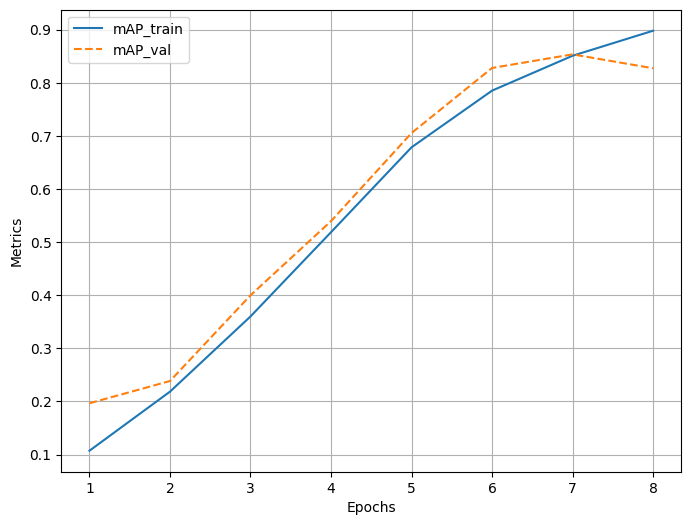

100%|██████████| 109/109 [00:00<00:00, 697.61it/s]


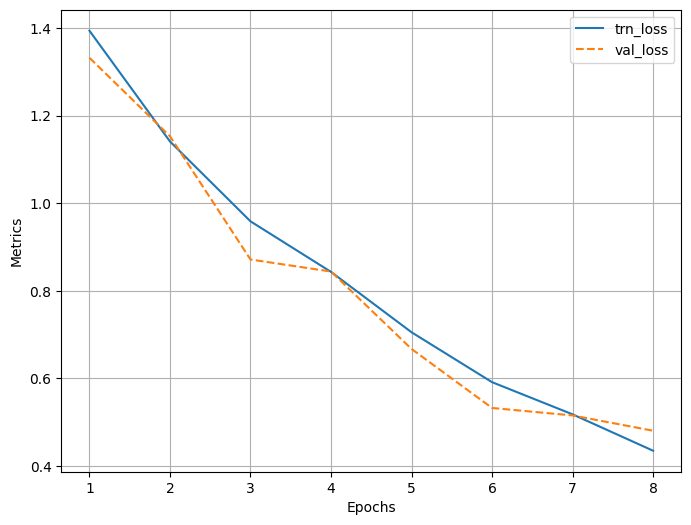

100%|██████████| 109/109 [00:00<00:00, 744.76it/s]


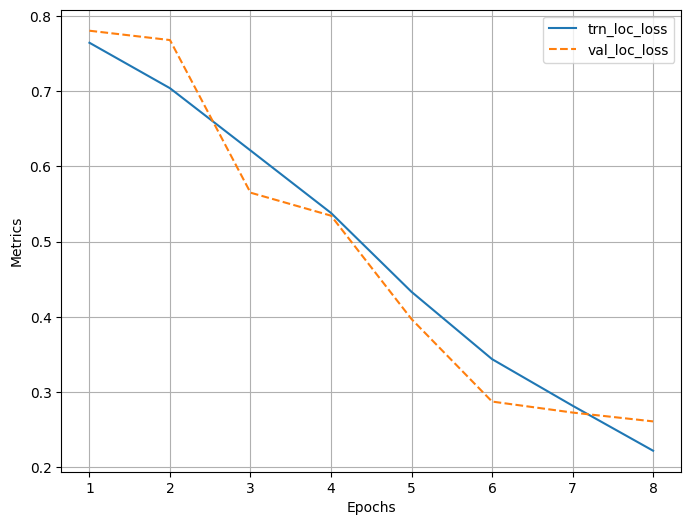

100%|██████████| 109/109 [00:00<00:00, 738.56it/s]


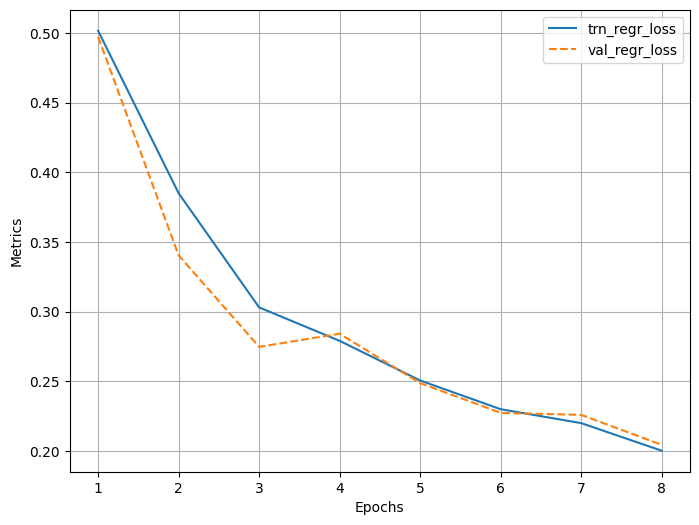

In [49]:
log.plot_epochs(['mAP_train','mAP_val']) # mAP график
log.plot_epochs(['trn_loss', 'val_loss']) # график суммарных потерь
log.plot_epochs(['trn_loc_loss', 'val_loc_loss']) # потери классификации
log.plot_epochs(['trn_regr_loss', 'val_regr_loss']) # потери регрессии

# **15. Сохраняем/загружаем модель**

In [ ]:
# save_path = 'ДИПЛОМ_5_8_FASTER_R-CNN_итог_c_mAP_ВОЕННЫЕ_САМОЛЕТЫ.pth'
# torch.save(model.state_dict(), save_path)
# !du -hsc {save_path} # size of the model on disk

In [ ]:
# load_path = '/content/FASTER_R-CNN_ДИПЛОМ_5_1_ВОЕННЫЕ_САМОЛЕТЫ.pth'
# #model.load_state_dict(torch.load(load_path)) #  # строка при загрузке на GРU
# model.load_state_dict(torch.load(load_path, map_location=torch.device('cpu'))) # строка при загрузке на СРU

# **16. Получаем коробки и классы для любой картинки в формате входящей картинки**

**1. Загружаем картинку и обрабатываем для модели в форме списка путей**

**2. Предсказываем bbs**

**3. Вытаскиваем первоначальную картинку**

**4. Масштабируем bbs**

**5. Накладываем bbs на первоначальную картинку**

In [56]:
# список путей до картинок, на которых нужно обнаружить объекты:
# image_lst = ['/content/JPEGImages/1021.jpg', '/content/JPEGImages/1030.jpg', '/content/JPEGImages/107.jpg']
# image_lst = ['/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/109.jpg', 
#              '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/1149.jpg',
#              '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/1378.jpg',
#              '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/1472.jpg']
# image_lst
image_lst = images_paths[8:11]

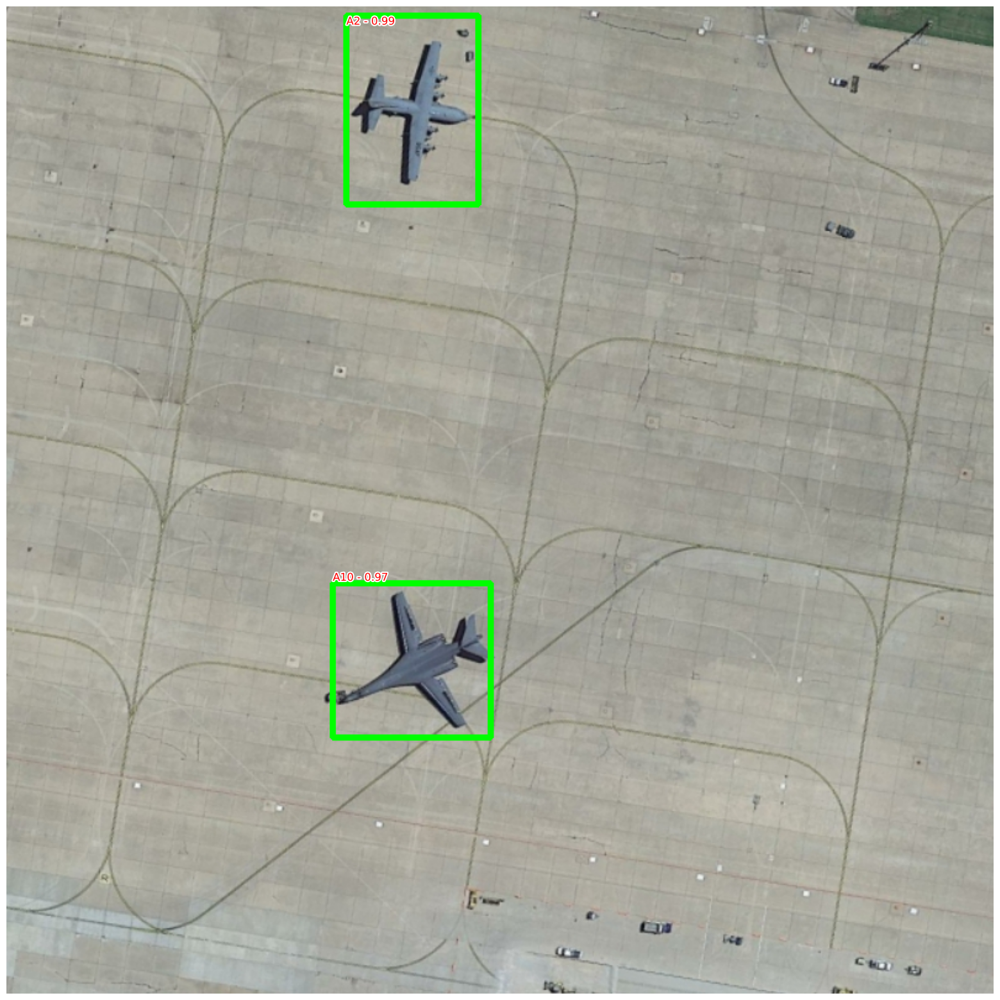

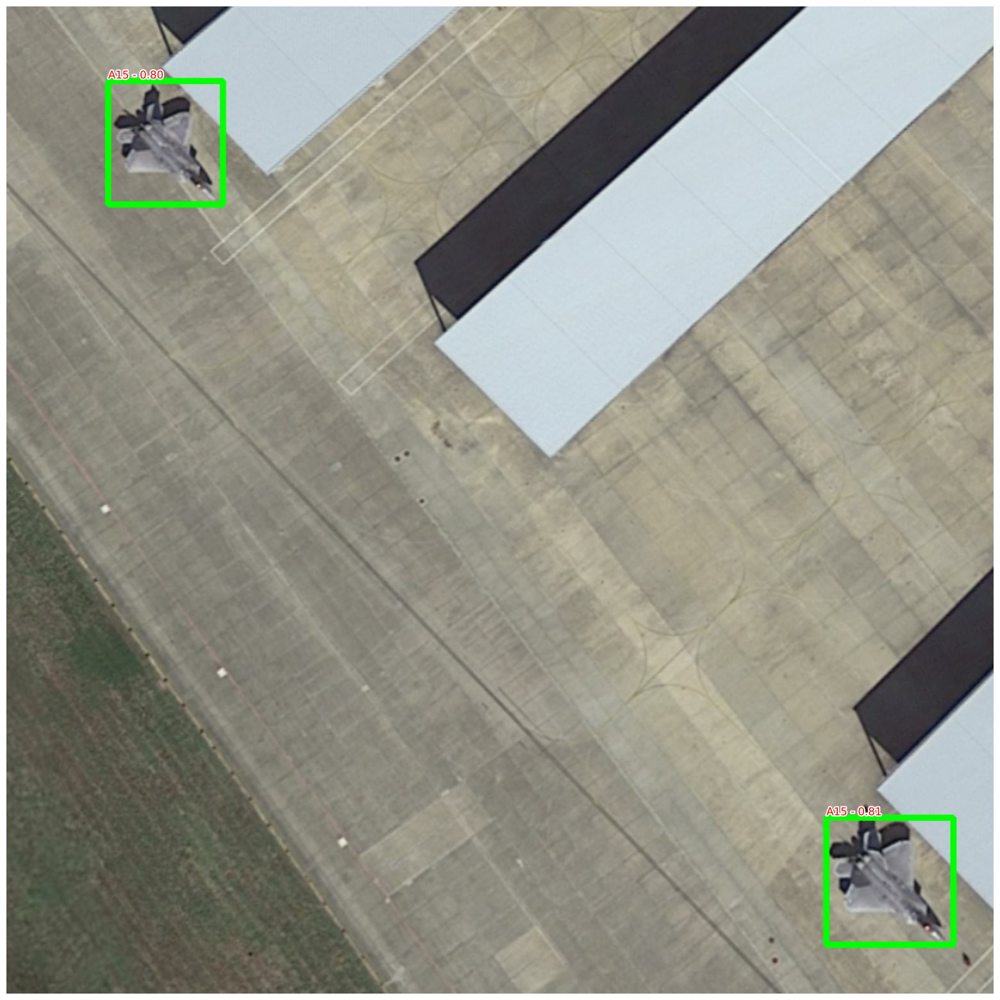

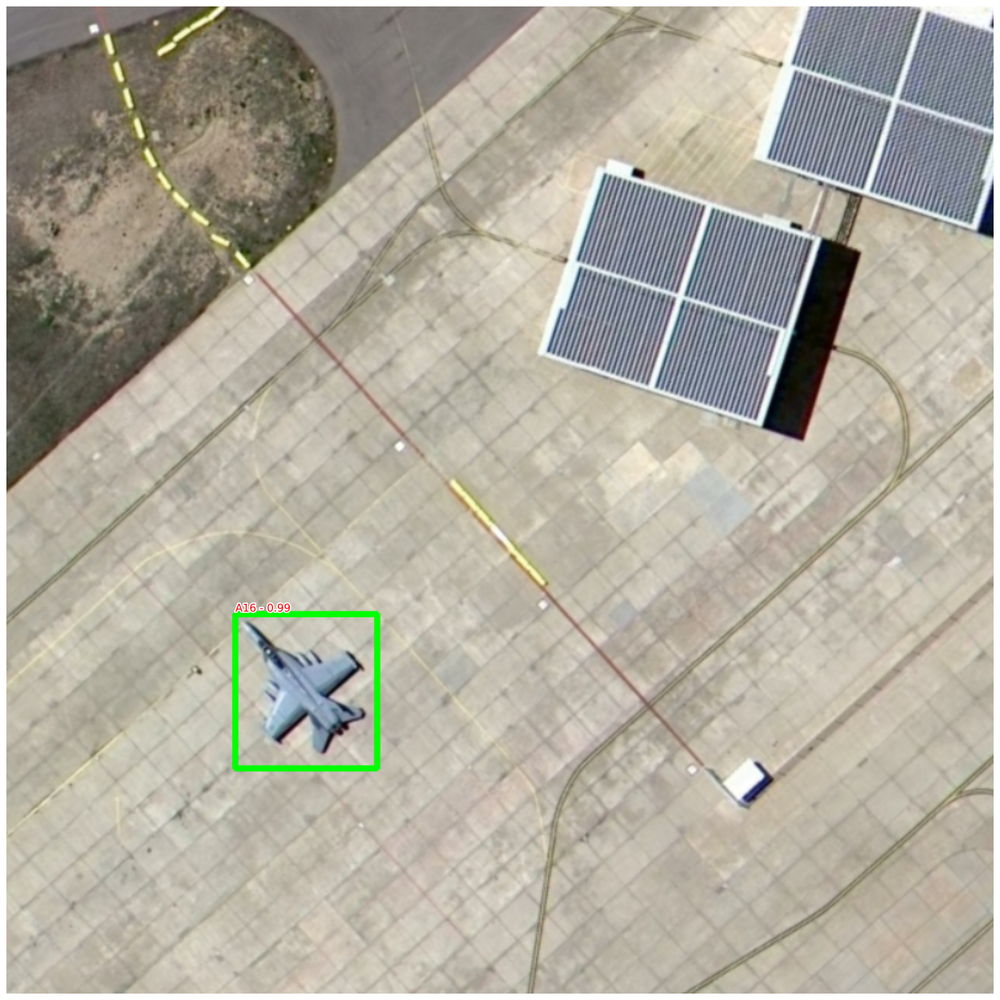

In [57]:
# обрабатывем картинку
def preprocess_img(img):
    img = torch.tensor(img).permute(2, 0 ,1)
    return img.float()

class AlienPic(Dataset):
    def __init__(self, lst, transforms=None):
        self.img_paths = lst
        self.transforms = transforms
        # self.img_paths = sorted([str(i) for i in Glob(self.root + '/images/images/*.jpg')])
        # self.xlm_paths = sorted([str(i) for i in Glob(self.root + '/annotation/annotation/VOC-format/*.xml')])
        # self.img_paths = sorted([k for k, v in roo])
        # self.xlm_paths = sorted([v for k, v in roo])
        #self.img_paths = self.root.image.to_list()
    def __len__(self):
        return len(self.img_paths)
    def __getitem__(self, idx):
        #----------------------
        # достаем факт размер картинки (Image.open достает W и H)
        w, h = 224, 224
        img_path = self.img_paths[idx]
        img = Image.open(img_path).convert('RGB')
        W, H = img.size
        #----------------------
        # достаем картинку, меняем размер (появляются 3-й канала)
        img = np.array(img.resize((w, h),
                       resample=Image.Resampling.BILINEAR))/255.
        #----------------------
        img = preprocess_img(img)
        #----------------------
        return img#, target
    def collate_fn(self, batch):
        return tuple(zip(*batch))

# делаем загрузчики данных
tt_ds = AlienPic(image_lst, transforms=get_transform(train=False)) # False True
tt_dl = DataLoader(tt_ds, batch_size=15, shuffle=False)#, collate_fn=train_ds.collate_fn)

# предсказываем bbox
from torchvision.ops import nms
def decode_output(output):
    bbs = output['boxes'].cpu().detach().numpy().astype(np.uint16)
    labels = np.array([targets2label[i] for i in output['labels'].cpu().detach().numpy()])
    confs = output['scores'].cpu().detach().numpy()
    idxs = nms(torch.tensor(bbs.astype(np.float32)), torch.tensor(confs), 0.05)
    bbs, confs, labels = [tensor[idxs] for tensor in [bbs, confs, labels]]
    if len(idxs) == 1:
        bbs, confs, labels = [np.array([tensor]) for tensor in [bbs, confs, labels]]
    return bbs.tolist(), confs.tolist(), labels.tolist()

model.eval()
prediction_list = []
for i, (images) in enumerate(tt_dl):
    imgs = list(img.to(device) for img in images)
    if i == 1: break
    images = [im for im in imgs]
    outputs = model(images)
    # print(outputs)
    for i, output in enumerate(outputs):
       bbs, confs, labels = decode_output(output)
       prediction_list.append([bbs, confs, labels])
      #  plot_img_bbox(images[i].cpu().permute(1,2,0), bbs)
      #  show(images[i].cpu().permute(1,2,0), bbs=bbs, texts=labels, sz=10)


# список кортежей с данными для каждого предсказанного bbox
res = [list(zip(i[0], np.round(i[1],3), i[2])) for i in prediction_list]

#res = list(zip(bbs, np.round(confs,3), labels))

# масштабируем полученные bbox до размеров нормальной картинки
# и вводим порог при превышении которого модель будет считать, что это самолет
def result(res):
  big_box = []
  for i,j in enumerate(res):
        w, h = 224, 224
        a = read(image_lst[i])
        W, H = a.shape[1], a.shape[0]
        bb=[]
        lb=[]
        score_=[]
        for _ in j:
              if _[1]<0.5: continue
              else:
                bbox = _[0]
                bbox = [int(i) for i in [_[0][0]/w*W, _[0][1]/h*H, _[0][2]/w*W, _[0][-1]/h*H]]
                bb.append(bbox)
                lb.append(_[-1])
                score_.append(_[1])
        big_box.append([bb, lb, score_])
  return big_box
big_box = result(res)
# print(big_box)
# надпись = []
# for i in list(zip([i for i in lb],score_)):
#   надпись.append(f'{i[0]} {i[1]}')

# !!!выводим результат
for i,j in enumerate(big_box):
  if len(j[0])<1:
    continue # если ниче не нашел, пропускаем
  else:
    metka = [f'{l} - {s:.2f}' for l,s in zip(j[1],j[-1])]
    show(image_lst[i], bbs=j[0], texts=metka)#, sz=10)

# **КОНЕЦ!!!**